In [46]:
### Analyse et manipulation des données
import pandas as pd
import numpy as np

### Visualisation de données
%matplotlib inline
from matplotlib import pyplot as plt
import seaborn as sns
import plotly.express as px
from yellowbrick.cluster import KElbowVisualizer

### Normalisation et modélisation des données avec K-Means et PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans,MeanShift, DBSCAN
from sklearn.metrics import silhouette_score , calinski_harabasz_score, davies_bouldin_score

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import FunctionTransformer
from yellowbrick.cluster import SilhouetteVisualizer
#!pip install kneed
from kneed import KneeLocator
from sklearn.neighbors import NearestNeighbors
from scipy.cluster.hierarchy import dendrogram, linkage


import datetime as dt
import warnings
warnings.filterwarnings('ignore')

In [47]:
df=pd.read_csv('my_df.csv')
df.head(2)

,customer_id,customer_unique_id,customer_state,order_id,order_item_id,product_id,payment_type,payment_installments,payment_value,review_score,order_purchase_timestamp,product_category_name,product_category_name_english
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,SP,00e7ee1b050b8499577073aeb2a297a1,1,a9516a079e37a9c9c36b9b78b10169e8,credit_card,2,146.87,4,2017-05-16 15:05:35,moveis_escritorio,office_furniture
1,8912fc0c3bbf1e2fbf35819e21706718,9eae34bbd3a474ec5d07949ca7de67c0,PA,c1d2b34febe9cd269e378117d6681172,1,a9516a079e37a9c9c36b9b78b10169e8,credit_card,1,275.79,1,2017-11-09 00:50:13,moveis_escritorio,office_furniture


In [48]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 94488 entries, 0 to 94487
Data columns (total 13 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   customer_id                    94488 non-null  object 
 1   customer_unique_id             94488 non-null  object 
 2   customer_state                 94488 non-null  object 
 3   order_id                       94488 non-null  object 
 4   order_item_id                  94488 non-null  int64  
 5   product_id                     94488 non-null  object 
 6   payment_type                   94488 non-null  object 
 7   payment_installments           94488 non-null  int64  
 8   payment_value                  94488 non-null  float64
 9   review_score                   94488 non-null  int64  
 10  order_purchase_timestamp       94488 non-null  object 
 11  product_category_name          94488 non-null  object 
 12  product_category_name_english  94488 non-null 

    Récence : combien de temps s'est-il écoulé depuis qu'un client nous a acheté quelque chose ? 
    Fréquence : la fréquence à laquelle un client achète chez nous 
    Valeur monétaire : la valeur totale des achats qu'un client a effectués

In [49]:
df['order_purchase_timestamp'] = pd.to_datetime(df['order_purchase_timestamp'])

In [50]:
df['order_purchase_timestamp'].max()

Timestamp('2018-08-29 15:00:37')

La dernière date d'achat est 29-08-2018. Nous pouvons déterminer notre date d'analyse comme 29-08-2018.

In [51]:
#recency

date = dt.datetime(2018,8,29)
recency=pd.DataFrame(df.groupby(['customer_unique_id']).agg({'order_purchase_timestamp':lambda x:((date-x.max()).days)}).reset_index())

recency.head(2)

,customer_unique_id,order_purchase_timestamp
0,0000366f3b9a7992bf8c76cfdf3221e2,110
1,0000b849f77a49e4a4ce2b2a4ca5be3f,113


In [52]:
#frequency

frequency=pd.DataFrame(df.drop_duplicates(subset='order_id').groupby(['customer_unique_id'])[['order_id']].count().reset_index())
frequency.head(5)

,customer_unique_id,order_id
0,0000366f3b9a7992bf8c76cfdf3221e2,1
1,0000b849f77a49e4a4ce2b2a4ca5be3f,1
2,0000f46a3911fa3c0805444483337064,1
3,0000f6ccb0745a6a4b88665a16c9f078,1
4,0004aac84e0df4da2b147fca70cf8255,1


In [53]:
#monetary

monetary=pd.DataFrame(df.groupby(['customer_unique_id'])[['payment_value']].sum().reset_index())
monetary.head(2)

,customer_unique_id,payment_value
0,0000366f3b9a7992bf8c76cfdf3221e2,141.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,27.19


In [56]:
RFM= recency.merge(frequency[['order_id', 'customer_unique_id']], on='customer_unique_id').merge(monetary[['payment_value', 'customer_unique_id']], on='customer_unique_id')
RFM

,customer_unique_id,order_purchase_timestamp,order_id,payment_value
0,0000366f3b9a7992bf8c76cfdf3221e2,110,1,141.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,113,1,27.19
2,0000f46a3911fa3c0805444483337064,536,1,86.22
3,0000f6ccb0745a6a4b88665a16c9f078,320,1,43.62
4,0004aac84e0df4da2b147fca70cf8255,287,1,196.89
...,...,...,...,...
91476,fffcf5a5ff07b0908bd4e2dbc735a684,446,1,2067.42
91477,fffea47cd6d3cc0a88bd621562a9d061,261,1,84.58
91478,ffff371b4d645b6ecea244b27531430a,567,1,112.46
91479,ffff5962728ec6157033ef9805bacc48,118,1,133.69


In [57]:
RFM = RFM.rename(columns={'order_purchase_timestamp':'Recency', 'order_id':'Frequency', 'payment_value': 'Monetary'})
RFM

,customer_unique_id,Recency,Frequency,Monetary
0,0000366f3b9a7992bf8c76cfdf3221e2,110,1,141.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,113,1,27.19
2,0000f46a3911fa3c0805444483337064,536,1,86.22
3,0000f6ccb0745a6a4b88665a16c9f078,320,1,43.62
4,0004aac84e0df4da2b147fca70cf8255,287,1,196.89
...,...,...,...,...
91476,fffcf5a5ff07b0908bd4e2dbc735a684,446,1,2067.42
91477,fffea47cd6d3cc0a88bd621562a9d061,261,1,84.58
91478,ffff371b4d645b6ecea244b27531430a,567,1,112.46
91479,ffff5962728ec6157033ef9805bacc48,118,1,133.69


In [58]:
rfm=RFM.copy()

In [59]:
rfm["R"] = pd.qcut(rfm["Recency"],5,labels=[5,4,3,2,1])
rfm["F"] = pd.qcut(rfm["Frequency"].rank(method="first"),5,labels=[1,2,3,4,5])
rfm["M"] = pd.qcut(rfm["Monetary"],5,labels=[1,2,3,4,5])
rfm["RFM_Score"] = rfm["R"].astype(str) +rfm["F"].astype(str) + rfm["M"].astype(str)

In [60]:
rfm

,customer_unique_id,Recency,Frequency,Monetary,R,F,M,RFM_Score
0,0000366f3b9a7992bf8c76cfdf3221e2,110,1,141.90,4,1,4,414
1,0000b849f77a49e4a4ce2b2a4ca5be3f,113,1,27.19,4,1,1,411
2,0000f46a3911fa3c0805444483337064,536,1,86.22,1,1,3,113
3,0000f6ccb0745a6a4b88665a16c9f078,320,1,43.62,2,1,1,211
4,0004aac84e0df4da2b147fca70cf8255,287,1,196.89,2,1,4,214
...,...,...,...,...,...,...,...,...
91476,fffcf5a5ff07b0908bd4e2dbc735a684,446,1,2067.42,1,5,5,155
91477,fffea47cd6d3cc0a88bd621562a9d061,261,1,84.58,3,5,2,352
91478,ffff371b4d645b6ecea244b27531430a,567,1,112.46,1,5,3,153
91479,ffff5962728ec6157033ef9805bacc48,118,1,133.69,4,5,4,454


In [14]:
seg_map = {
    r'[1-2][1-2]': 'Hiberner',
    r'[1-2][3-4]': 'À risque',
    r'[1-2]5': 'Ne peut pas perdre',
    r'3[1-2]': 'Sur le point de dormir',
    r'33': 'Besoin attention',
    r'[3-4][4-5]': 'Clients fidèles',
    r'41': 'Prometteur',
    r'51': 'nouveaux clients',
    r'[4-5][2-3]': 'Loyalistes potentielss',
    r'5[4-5]': 'Champions'
}

In [61]:
rfm['Segment'] = rfm['R'].astype(str) + rfm['F'].astype(str)
rfm['Segment'] = rfm['Segment'].replace(seg_map, regex=True)
rfm.head()

,customer_unique_id,Recency,Frequency,Monetary,R,F,M,RFM_Score,Segment
0,0000366f3b9a7992bf8c76cfdf3221e2,110,1,141.90,4,1,4,414,Prometteur
1,0000b849f77a49e4a4ce2b2a4ca5be3f,113,1,27.19,4,1,1,411,Prometteur
2,0000f46a3911fa3c0805444483337064,536,1,86.22,1,1,3,113,Hiberner
3,0000f6ccb0745a6a4b88665a16c9f078,320,1,43.62,2,1,1,211,Hiberner
4,0004aac84e0df4da2b147fca70cf8255,287,1,196.89,2,1,4,214,Hiberner


In [62]:
rfm_gr=rfm.groupby('Segment').mean()

In [63]:
rfm_gr

,Recency,Frequency,Monetary
Segment,,,
Besoin attention,217.702829,1.000000,146.225054
Champions,43.561415,1.094902,173.703235
Clients fidèles,175.810942,1.086592,167.013214
Hiberner,393.297444,1.000000,159.752076
Loyalistes potentielss,88.710446,1.000000,162.033363
Ne peut pas perdre,391.631336,1.144673,177.039799
Prometteur,133.694064,1.000000,163.578316
Sur le point de dormir,218.061032,1.000000,152.393919
nouveaux clients,44.054061,1.000000,158.637972


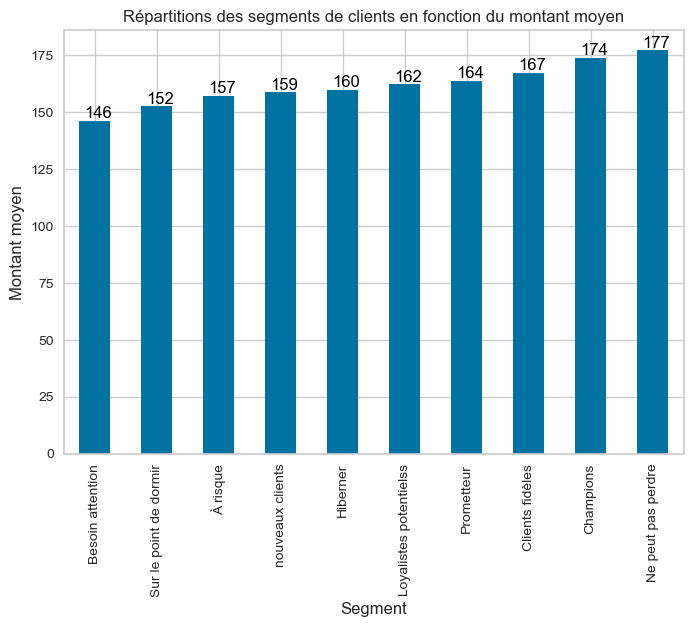

In [64]:
graph=rfm.groupby(['Segment']).agg('Monetary').mean().sort_values().plot(kind='bar')
for p in graph.patches:
        graph.annotate('{:.0f}'.format(p.get_height()), (p.get_x()+0.3, p.get_height()),
                    ha='center', va='bottom',
                    color= 'black')
plt.ylabel('Montant moyen')
plt.title('Répartitions des segments de clients en fonction du montant moyen')
plt.show()

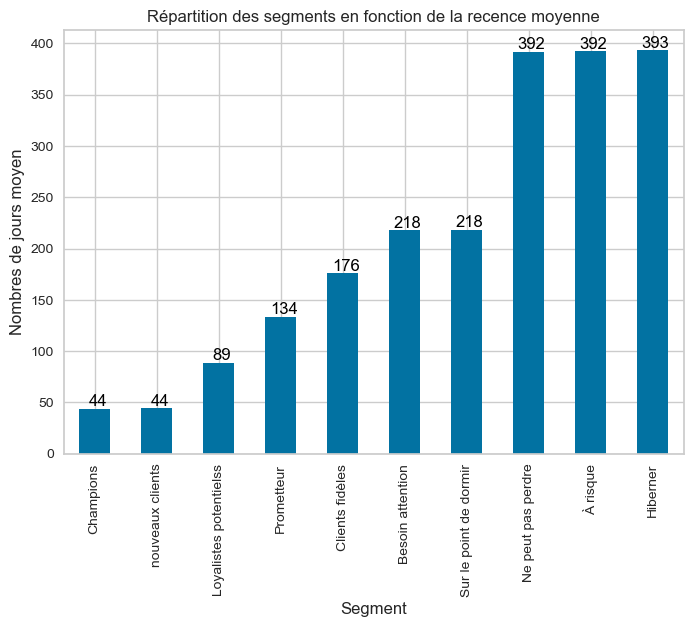

In [65]:
graph=rfm.groupby(['Segment']).agg('Recency').mean().sort_values().plot(kind='bar')
for p in graph.patches:
        graph.annotate('{:.0f}'.format(p.get_height()), (p.get_x()+0.3, p.get_height()),
                    ha='center', va='bottom',
                    color= 'black')
plt.ylabel('Nombres de jours moyen')
plt.title('Répartition des segments en fonction de la recence moyenne')
plt.show()

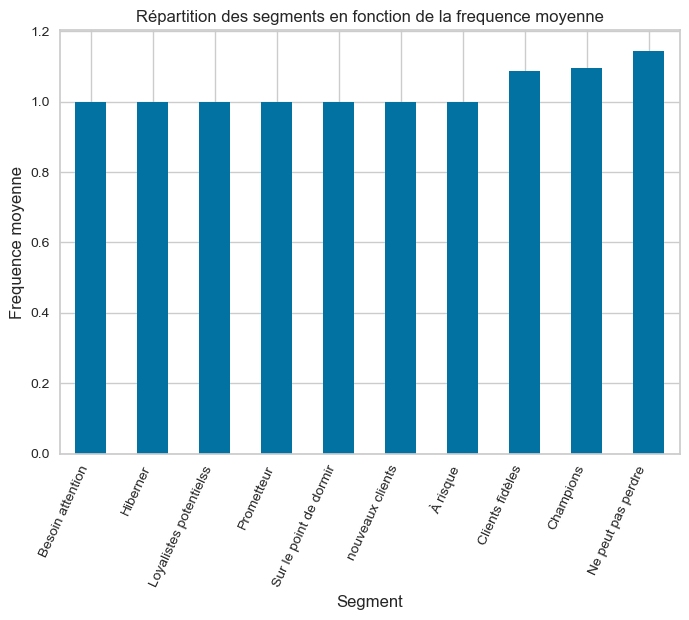

In [66]:
graph = rfm.groupby(['Segment']).agg('Frequency').mean().sort_values().plot(kind='bar')
plt.xticks(rotation=65, ha='right');
plt.ylabel('Frequence moyenne')
plt.title('Répartition des segments en fonction de la frequence moyenne')
plt.show()

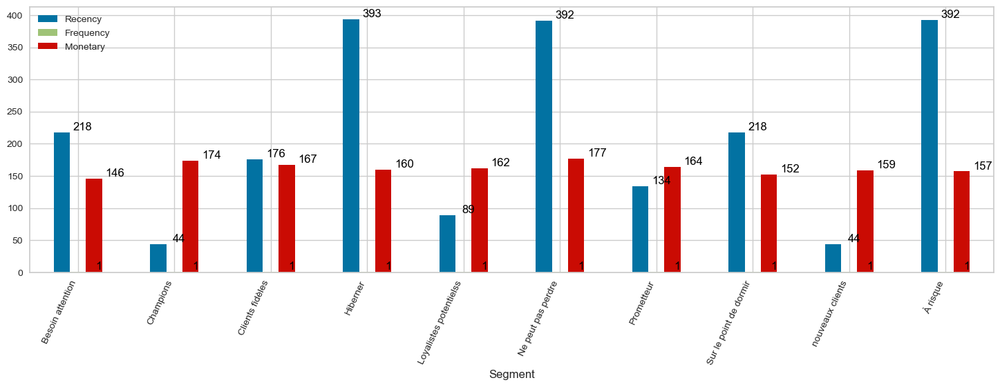

In [67]:
graph=rfm_gr.plot(kind = "bar", figsize=(18,5))
for p in graph.patches:
        graph.annotate('{:.0f}'.format(p.get_height()), (p.get_x()+0.3, p.get_height()),
                    ha='center', va='bottom',
                    color= 'black')
plt.xticks(rotation=65, ha='right');

In [68]:
rfm_agg = rfm.groupby('RFM_Score').agg({'Recency':'mean','Frequency':'mean','Monetary':'mean'})

In [69]:
rfm_agg

,Recency,Frequency,Monetary
RFM_Score,,,
111,476.632242,1.000000,37.199496
112,468.602041,1.000000,69.198125
113,470.789116,1.000000,107.300503
114,470.058252,1.000000,161.594272
115,475.392405,1.000000,435.868439
...,...,...,...
551,44.188088,1.017241,37.410893
552,40.564743,1.039002,68.819220
553,43.513591,1.111588,105.455536


In [71]:
import plotly.express as px
px.scatter_3d(RFM,x='Recency',y='Frequency',z='Monetary' )

In [72]:
df_kmeans = RFM.copy()

df_kmeans = df_kmeans.iloc[:,1:]
scaler=StandardScaler()
scaled=scaler.fit_transform(df_kmeans)
df_kmeans_scaled = pd.DataFrame(scaled, columns=df_kmeans.columns)
df_kmeans_scaled

,Recency,Frequency,Monetary
0,-0.823425,-0.159399,-0.091853
1,-0.803765,-0.159399,-0.607343
2,1.968376,-0.159399,-0.342071
3,0.552815,-0.159399,-0.533509
4,0.336549,-0.159399,0.155265
...,...,...,...
91476,1.378559,-0.159399,8.561165
91477,0.166157,-0.159399,-0.349441
91478,2.171536,-0.159399,-0.224152
91479,-0.770997,-0.159399,-0.128747


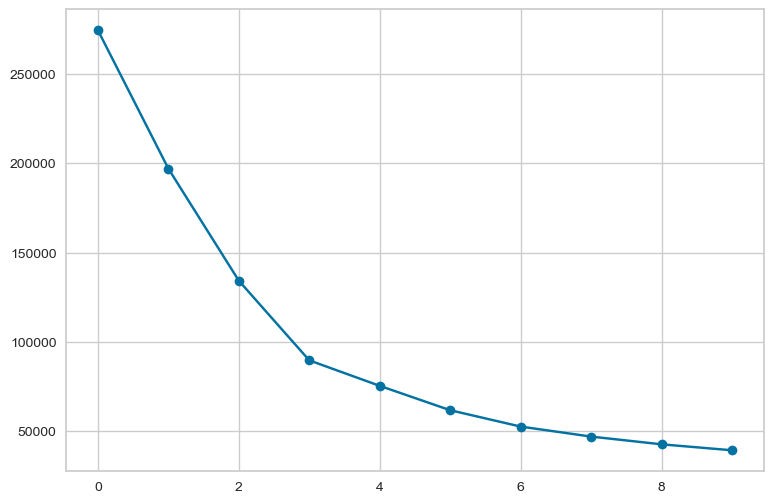

In [73]:
inertia=[]

for i in np.arange(1,11):
    kmeans=KMeans(n_clusters=i)
    kmeans.fit(df_kmeans_scaled)
    inertia.append(kmeans.inertia_)


plt.figure(figsize=(9,6))
plt.plot(inertia, marker="o")

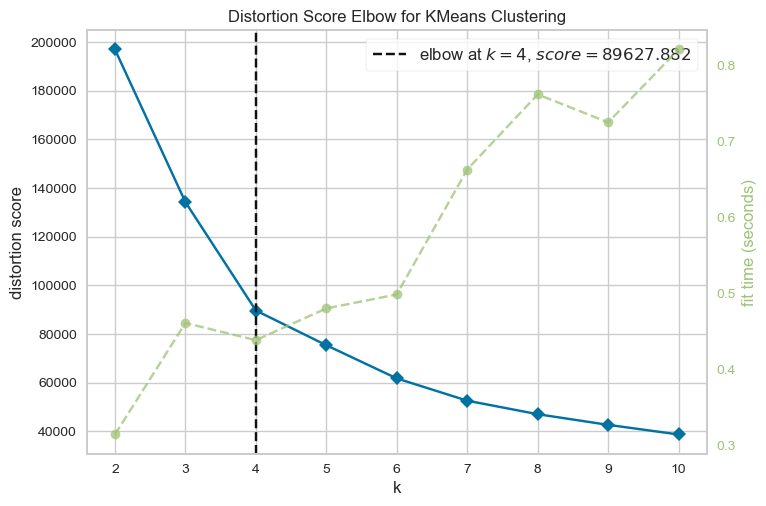

In [21]:

kmeans = KMeans(n_clusters = i) 
visualizer = KElbowVisualizer(kmeans, k=( 2 , 11 ))
visualizer.fit(df_kmeans_scaled)         
visualizer.show();

In [22]:
silhouette_coef = []
number_of_cluster = range(2, 7)

for i in range (2, 7):
    kmeans = KMeans(n_clusters = i)
    kmeans.fit(df_kmeans_scaled)
    score = silhouette_score(df_kmeans_scaled, kmeans.labels_)
    silhouette_coef.append(score)
    labels = kmeans.labels_
    #silhouette_avg = silhouette_score(rfm_scaled, kmeans.labels_)
    print("Pour n_clusters={0}, le silhouette score est {1}".format(i, score))

Pour n_clusters=2, le silhouette score est 0.7406325291737019
Pour n_clusters=3, le silhouette score est 0.4555611586462552
Pour n_clusters=4, le silhouette score est 0.4890026539404073
Pour n_clusters=5, le silhouette score est 0.4171991251411587
Pour n_clusters=6, le silhouette score est 0.43698620357644


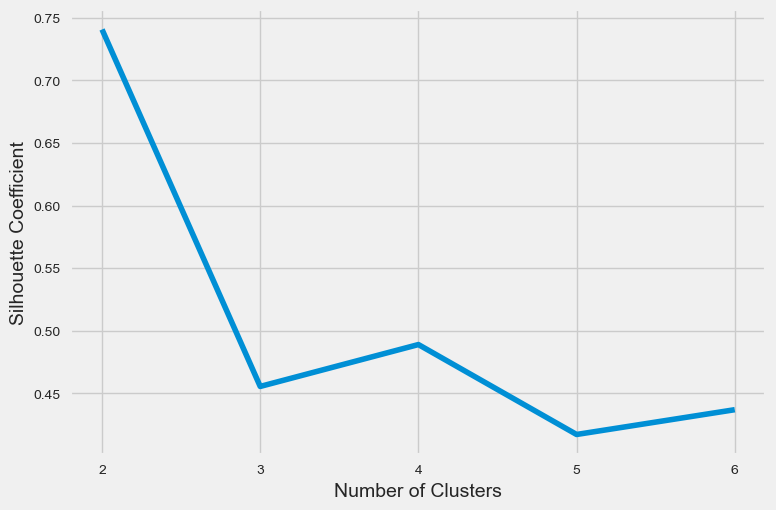

In [23]:
plt.style.use ("fivethirtyeight")
plt.plot (range (2, 7), silhouette_coef)
plt.xticks (range (2, 7))
plt.xlabel ("Number of Clusters")
plt.ylabel ("Silhouette Coefficient")
plt.show ()

In [74]:
kmeans = KMeans(n_clusters = 4)
kmeans.fit(df_kmeans_scaled)

KMeans(n_clusters=4)

In [25]:
silhouette_score_km = silhouette_score(df_kmeans_scaled, kmeans.labels_)
silhouette_score_km

0.4889469305025707

In [26]:
calinski_score_km = calinski_harabasz_score(df_kmeans_scaled, kmeans.labels_)
calinski_score_km

62876.01677057311

In [27]:
davies_bouldin_Score_km = davies_bouldin_score(df_kmeans_scaled, kmeans.labels_)
davies_bouldin_Score_km

0.681854827747918

   |Metrics|Score|
   |-------|-----|
   |Silhouette Score|0.49|
   |Calinski harabasz Score|62876.02|
   |Davies Bouldin Score|0.68|

In [75]:
rfm_scaled_km= df_kmeans_scaled
kmeans=KMeans(n_clusters=4)
kmeans.fit(df_kmeans_scaled)
df_kmeans_scaled['Clusters_km']=(kmeans.labels_)

In [29]:
df_kmeans_scaled

,Recency,Frequency,Monetary,Clusters_km
0,-0.823425,-0.159399,-0.091853,0
1,-0.803765,-0.159399,-0.607343,0
2,1.968376,-0.159399,-0.342071,1
3,0.552815,-0.159399,-0.533509,1
4,0.336549,-0.159399,0.155265,1
...,...,...,...,...
91476,1.378559,-0.159399,8.561165,2
91477,0.166157,-0.159399,-0.349441,1
91478,2.171536,-0.159399,-0.224152,1
91479,-0.770997,-0.159399,-0.128747,0


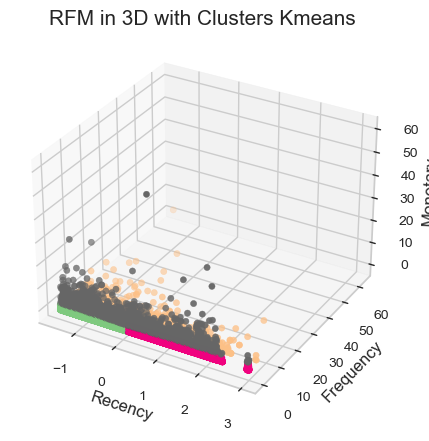

In [45]:
fig = plt.figure(figsize = (8, 5))
ax = plt.axes(projection ="3d")

# Creating plot
ax.scatter3D(df_kmeans_scaled.Recency, df_kmeans_scaled.Frequency, df_kmeans_scaled.Monetary, c=df_kmeans_scaled.Clusters_km, cmap='Accent')
ax.set_xlabel('Recency')
ax.set_ylabel('Frequency')
ax.set_zlabel('Monetary')
plt.title('RFM in 3D with Clusters Kmeans', size=15)
ax.set(facecolor='white')
plt.show()


In [76]:
px.scatter_3d(df_kmeans_scaled,x='Recency',y='Frequency',z='Monetary',color= 'Clusters_km', )

In [77]:
result_km = df_kmeans_scaled['Clusters_km'].value_counts()
result_km

0    49627
1    36683
2     2681
3     2490
Name: Clusters_km, dtype: int64

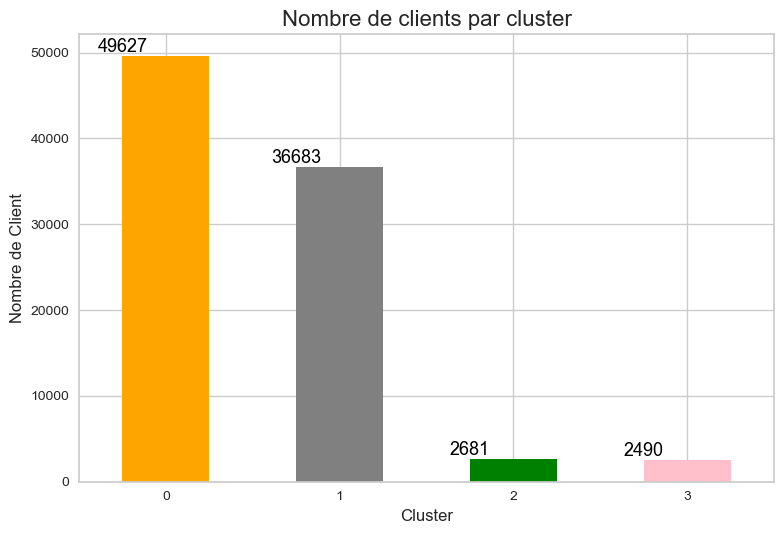

In [98]:
graph = result_km.plot(kind="bar", color=['Orange','gray','Green','pink','cyan']);

for p in graph.patches:
        graph.annotate('{:.0f}'.format(p.get_height()), (p.get_x(), p.get_height()),
                    ha='center', va='bottom',
                    color= 'black', fontsize = 13)
plt.xticks(rotation=0)
plt.title("Nombre de clients par cluster", size=16)
plt.ylabel("Nombre de Client")
plt.xlabel("Cluster")
plt.tight_layout()

In [79]:
df_kmeans_scaled.groupby('Clusters_km')["Recency","Frequency","Monetary"].mean()

,Recency,Frequency,Monetary
Clusters_km,,,
0,-0.720291,-0.159399,-0.137461
1,0.981682,-0.159399,-0.144893
2,-0.113963,5.228947,0.550930
3,0.016218,-0.104868,4.281066


## DBSCAN

 Si la valeur d'  epsilon choisie est trop petite, un nombre plus élevé de clusters sera créé et davantage de points de données seront considérés comme du bruit. Alors que, s'il est choisi trop grand, divers petits clusters fusionneront en un grand cluster, et nous perdrons des détails

In [81]:
df_dbscan = RFM.copy()
df_dbscan = df_dbscan.iloc[:15000,1:]
df_dbscan

,Recency,Frequency,Monetary
0,110,1,141.90
1,113,1,27.19
2,536,1,86.22
3,320,1,43.62
4,287,1,196.89
...,...,...,...
14995,124,1,143.25
14996,98,1,125.45
14997,348,1,101.83
14998,496,1,101.14


In [82]:
scaler=StandardScaler()
scaled=scaler.fit_transform(df_dbscan)
df_dbscan_scaled = pd.DataFrame(scaled, columns=df_dbscan.columns)
df_dbscan_scaled

,Recency,Frequency,Monetary
0,-0.825732,-0.163001,-0.088875
1,-0.806165,-0.163001,-0.564647
2,1.952863,-0.163001,-0.319814
3,0.543998,-0.163001,-0.496502
4,0.328754,-0.163001,0.139203
...,...,...,...
14995,-0.734417,-0.163001,-0.083275
14996,-0.904003,-0.163001,-0.157103
14997,0.726628,-0.163001,-0.255069
14998,1.691962,-0.163001,-0.257931


In [39]:
for eps in [i/10 for i in range(3, 7)]:
  for min_samples in range(3,7):
    print("\neps={}".format(eps))
    print("min_samples={}".format(min_samples))
    dbscan = DBSCAN(eps=eps, min_samples=min_samples)
    labels = dbscan.fit_predict(df_dbscan_scaled)
    silh = silhouette_score(df_dbscan_scaled, labels)
    print("Clusters present: {}".format(np.unique(labels)))
    print("Cluster sizes: {}".format(np.bincount(labels + 1)))
    print("Silhouette Score: {}".format(silh))
    


eps=0.3
min_samples=3
Clusters present: [-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21]
Cluster sizes: [   97 14379    40   381     3    17     4     6     3     3     3     7
     4    12     6     8     3     4     4     7     3     3     3]
Silhouette Score: 0.4545143336688686

eps=0.3
min_samples=4
Clusters present: [-1  0  1  2  3  4  5  6  7  8  9 10 11 12]
Cluster sizes: [  135 14371    38   379    17     4     6     7    12     5     7     8
     4     7]
Silhouette Score: 0.4410269968838989

eps=0.3
min_samples=5
Clusters present: [-1  0  1  2  3  4  5  6  7  8  9 10 11]
Cluster sizes: [  162 14365    38   375    13     7     5     7     8     9     5     1
     5]
Silhouette Score: 0.4399371573016104

eps=0.3
min_samples=6
Clusters present: [-1  0  1  2  3  4  5  6  7]
Cluster sizes: [  200 14361    37   369     6     7     9     6     5]
Silhouette Score: 0.43907905936049485

eps=0.4
min_samples=3
Clusters present: [-1  0  1  2  3  4  5  6  7  8  9 10

In [93]:
dbscan = DBSCAN(eps = 0.6, min_samples=5)
dbscan.fit_predict(df_dbscan_scaled)

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

In [41]:
silhouette_score_db = silhouette_score(df_dbscan_scaled, dbscan.labels_)
silhouette_score_db

0.7296447606842419

In [42]:
calinski_score_db = calinski_harabasz_score(df_dbscan_scaled, dbscan.labels_)
calinski_score_db 

2549.4619370245955

In [43]:
davies_bouldin_Score_db = davies_bouldin_score(df_dbscan_scaled, dbscan.labels_)
davies_bouldin_Score_db

1.153178225423148

|Metrics|Score|
|-------|-----|
|Silhouette Score|0.73|
|Calinski harabasz Score|2549.46|
|Davies Bouldin Score|1.15|

In [94]:
df_dbscan_scaled['Clusters_db']=(dbscan.labels_)

In [95]:
df_dbscan_scaled

,Recency,Frequency,Monetary,Clusters_db
0,-0.825732,-0.163001,-0.088875,0
1,-0.806165,-0.163001,-0.564647,0
2,1.952863,-0.163001,-0.319814,0
3,0.543998,-0.163001,-0.496502,0
4,0.328754,-0.163001,0.139203,0
...,...,...,...,...
14995,-0.734417,-0.163001,-0.083275,0
14996,-0.904003,-0.163001,-0.157103,0
14997,0.726628,-0.163001,-0.255069,0
14998,1.691962,-0.163001,-0.257931,0


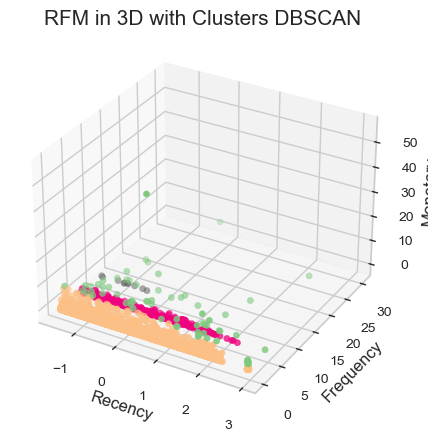

In [85]:
fig = plt.figure(figsize = (8, 5))
ax = plt.axes(projection ="3d")

# Creating plot
ax.scatter3D(df_dbscan_scaled.Recency, df_dbscan_scaled.Frequency, df_dbscan_scaled.Monetary, c=df_dbscan_scaled.Clusters_db, cmap='Accent')
ax.set_xlabel('Recency')
ax.set_ylabel('Frequency')
ax.set_zlabel('Monetary')
plt.title('RFM in 3D with Clusters DBSCAN', size=15)
ax.set(facecolor='white')
plt.show()

In [86]:
import plotly.express as px
px.scatter_3d(df_dbscan_scaled,x='Recency',y='Frequency',z='Monetary',color= 'Clusters_db', )


In [87]:
df_dbscan_scaled.groupby('Clusters_db').mean()

,Recency,Frequency,Monetary
Clusters_db,,,
-1,0.638179,4.709396,6.211730
0,0.002272,-0.163001,-0.038609
1,-0.167188,4.941415,0.377445
2,-0.891610,10.045830,0.147622


In [69]:
result_db = df_dbscan_scaled['Clusters_db'].value_counts()
result_db

 0    14528
 1      396
-1       66
 2       10
Name: Clusters_db, dtype: int64

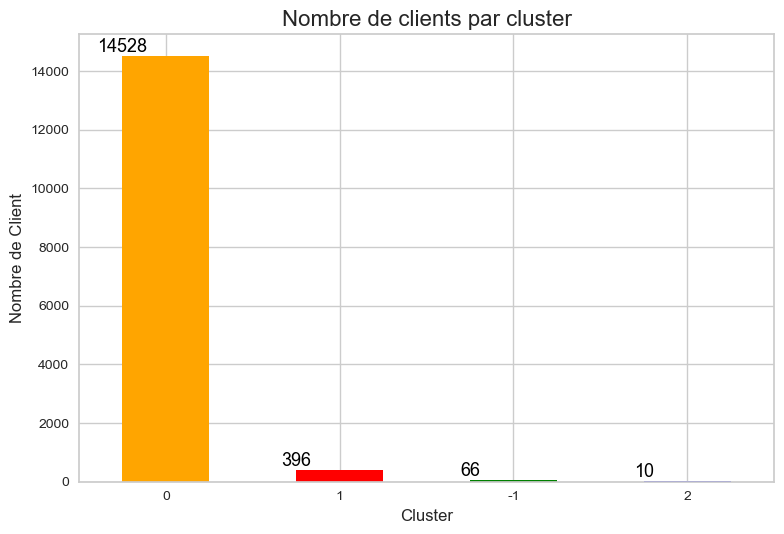

In [70]:
graph = result_db.plot(kind="bar", color=['Orange','Red','Green','blue','pink','cyan',]);
for p in graph.patches:
        graph.annotate('{:.0f}'.format(p.get_height()), (p.get_x(), p.get_height()),
                    ha='center', va='bottom',
                    color= 'black', fontsize = 13)
plt.xticks(rotation=0)
plt.title("Nombre de clients par cluster", size=16)
plt.ylabel("Nombre de Client")
plt.xlabel("Cluster")
plt.tight_layout()

## HC

In [100]:
df_hc = RFM.copy()
df_hc = df_hc.iloc[:15000,1:]
df_hc

,Recency,Frequency,Monetary
0,110,1,141.90
1,113,1,27.19
2,536,1,86.22
3,320,1,43.62
4,287,1,196.89
...,...,...,...
14995,124,1,143.25
14996,98,1,125.45
14997,348,1,101.83
14998,496,1,101.14


In [101]:
scaler=StandardScaler()
scaled=scaler.fit_transform(df_hc )
df_hc_scaled = pd.DataFrame(scaled, columns=df_hc .columns)
df_hc_scaled

,Recency,Frequency,Monetary
0,-0.825732,-0.163001,-0.088875
1,-0.806165,-0.163001,-0.564647
2,1.952863,-0.163001,-0.319814
3,0.543998,-0.163001,-0.496502
4,0.328754,-0.163001,0.139203
...,...,...,...
14995,-0.734417,-0.163001,-0.083275
14996,-0.904003,-0.163001,-0.157103
14997,0.726628,-0.163001,-0.255069
14998,1.691962,-0.163001,-0.257931


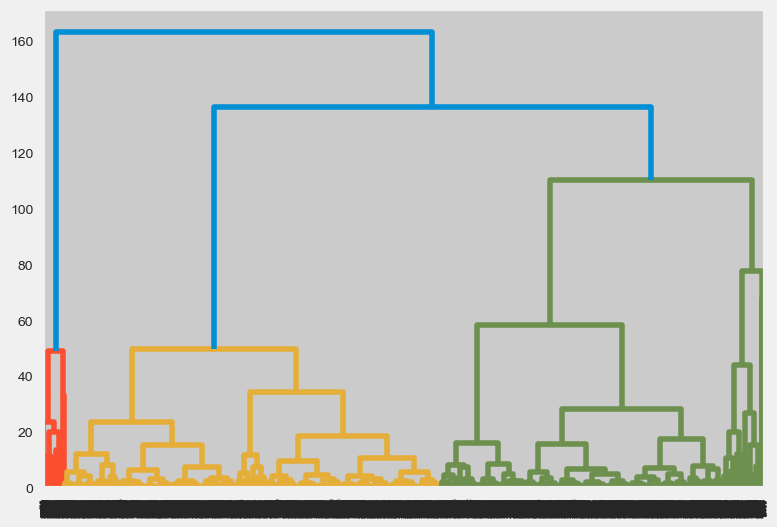

In [53]:
linkage_data = linkage(df_hc_scaled, method = 'ward', metric = 'euclidean')
dendrogram(linkage_data)
plt.tight_layout()
plt.show()

In [102]:
from sklearn.cluster import AgglomerativeClustering
hc = AgglomerativeClustering(n_clusters = 4, affinity = 'euclidean', linkage = 'ward')
y_hc = hc.fit_predict(df_hc_scaled)

In [55]:
silhouette_score_hc = silhouette_score(df_hc_scaled, hc.labels_)
silhouette_score_hc

0.4707267500738035

In [56]:
calinski_score_hc = calinski_harabasz_score(df_hc_scaled, hc.labels_)
calinski_score_hc 

8745.887023307028

In [57]:
davies_bouldin_Score_hc = davies_bouldin_score(df_hc_scaled, hc.labels_)
davies_bouldin_Score_hc

0.8240108347121957

|Metrics|Score|
|-------|-----|
|Silhouette Score|0.47|
|Calinski harabasz Score|8745.9|
|Davies Bouldin Score|0.82|

In [103]:
df_hc_scaled['Clusters_hc']=(hc.labels_)
df_hc_scaled

,Recency,Frequency,Monetary,Clusters_hc
0,-0.825732,-0.163001,-0.088875,2
1,-0.806165,-0.163001,-0.564647,2
2,1.952863,-0.163001,-0.319814,1
3,0.543998,-0.163001,-0.496502,1
4,0.328754,-0.163001,0.139203,1
...,...,...,...,...
14995,-0.734417,-0.163001,-0.083275,2
14996,-0.904003,-0.163001,-0.157103,2
14997,0.726628,-0.163001,-0.255069,1
14998,1.691962,-0.163001,-0.257931,1


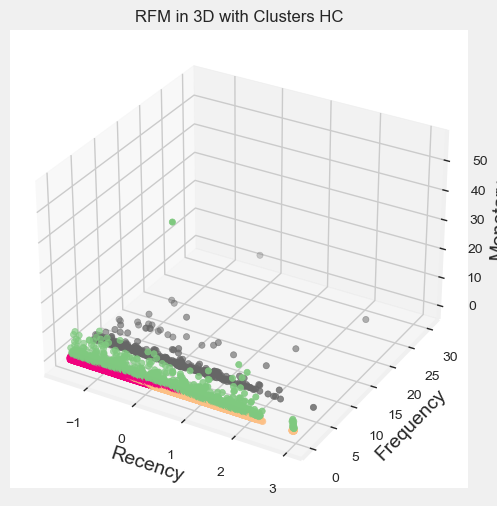

In [59]:
fig = plt.figure(figsize = (8, 5))
ax = plt.axes(projection ="3d")

# Creating plot
ax.scatter3D(df_hc_scaled.Recency, df_hc_scaled.Frequency, df_hc_scaled.Monetary, c=df_hc_scaled.Clusters_hc, cmap='Accent')
ax.set_xlabel('Recency')
ax.set_ylabel('Frequency')
ax.set_zlabel('Monetary')
plt.tight_layout()
plt.title('RFM in 3D with Clusters HC', size=12)
ax.set(facecolor='white')
plt.show()

In [60]:
df_hc_scaled.groupby('Clusters_hc').mean()

,Recency,Frequency,Monetary
Clusters_hc,,,
0,0.378206,-0.163001,2.559208
1,0.921985,-0.163001,-0.215448
2,-0.722409,-0.163001,-0.155893
3,-0.151566,5.368707,0.579165


In [104]:
result_hc = df_hc_scaled['Clusters_hc'].value_counts()
result_hc

2    7834
1    5854
0     870
3     442
Name: Clusters_hc, dtype: int64

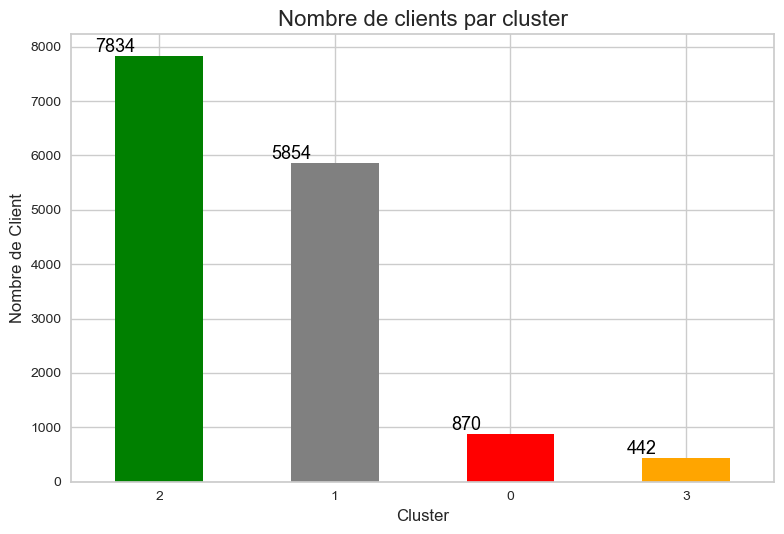

In [107]:
graph = result_hc.plot(kind="bar", color=['Green','gray','red','Orange',]);

for p in graph.patches:
        graph.annotate('{:.0f}'.format(p.get_height()), (p.get_x(), p.get_height()),
                    ha='center', va='bottom',
                    color= 'black', fontsize = 13)
plt.xticks(rotation=0)
plt.title("Nombre de clients par cluster", size=16)
plt.ylabel("Nombre de Client")
plt.xlabel("Cluster")
plt.tight_layout()

In [78]:
Campare_Models = pd.DataFrame({'Model_Name':['KMeans','DBSCAN','Hierarchical'],
                           'silhouette score':['0.49', '0.73', '0.47'],
                           'calinski_harabasz score':['62876.02', '2549.46', '8745.9'],
                           'davies_bouldin score':['0.68', '1.15', '0.82']
                           })

Campare_Models.style.set_properties(**{'text-align': 'center'},**{'background-color': '#38ea7a'},
                                   **{'color': 'black'})

,Model_Name,silhouette score,calinski_harabasz score,davies_bouldin score
0,KMeans,0.49,62876.02,0.68
1,DBSCAN,0.73,2549.46,1.15
2,Hierarchical,0.47,8745.9,0.82


    1- Silhouette Score 
    
Plus les coefficients de silhouette sont élevés (plus ils sont proches de +1), plus la séparation entre les clusters est importante.
    
    
    
    2- Indice Calinski Harabaz

L'indice de Calinski Harabaz est basé sur le principe du rapport de variance. Ce rapport est calculé entre deux paramètres de diffusion intra-cluster et de dispersion inter-cluster. Plus l'indice est élevé, meilleur est le regroupement.

    3- Indice Davies Bouldin (DB)

L'indice de Davies Bouldin est basé sur le principe des distances avec et entre les clusters. Il est couramment utilisé pour décider du nombre de clusters dans lesquels les points de données doivent être étiquetés. Il est différent des deux autres car la valeur de cet indice devrait être faible. Ainsi, le motif principal est de diminuer l'indice DB.






Le meilleur modèle est **KMEANS**

In [80]:
RFMK = RFM.copy()
RFMK['Kmeans_seg'] = (kmeans.labels_)

RFMK

,customer_unique_id,Recency,Frequency,Monetary,Kmeans_seg
0,0000366f3b9a7992bf8c76cfdf3221e2,110,1,141.90,0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,113,1,27.19,0
2,0000f46a3911fa3c0805444483337064,536,1,86.22,1
3,0000f6ccb0745a6a4b88665a16c9f078,320,1,43.62,1
4,0004aac84e0df4da2b147fca70cf8255,287,1,196.89,1
...,...,...,...,...,...
91476,fffcf5a5ff07b0908bd4e2dbc735a684,446,1,2067.42,3
91477,fffea47cd6d3cc0a88bd621562a9d061,261,1,84.58,1
91478,ffff371b4d645b6ecea244b27531430a,567,1,112.46,1
91479,ffff5962728ec6157033ef9805bacc48,118,1,133.69,0


In [82]:
RFMK.groupby('Kmeans_seg')["Recency","Frequency","Monetary"].mean()

,Recency,Frequency,Monetary
Kmeans_seg,,,
0,125.737179,1.000000,131.750912
1,385.440695,1.000000,130.097128
2,238.120884,1.011245,1114.987305
3,218.256621,2.111153,284.935684


In [84]:
ksegment_lst = df_kmeans_scaled['Clusters_km']
ksegment_cluster = []

for i in ksegment_lst:
    
    if i == 0:
        cluster = 'nouveau'
        ksegment_cluster.append(cluster)
    elif i == 1:
        cluster = 'perdu'
        ksegment_cluster.append(cluster)
    elif i == 2:
        cluster = 'loyal'
        ksegment_cluster.append(cluster)
    else:
        cluster = 'meilleur'
        ksegment_cluster.append(cluster)

In [85]:
df_kmeans_scaled['k_means_segment'] = ksegment_cluster

df_kmeans_scaled

,Recency,Frequency,Monetary,Clusters_km,k_means_segment
0,-0.823425,-0.159399,-0.091853,0,nouveau
1,-0.803765,-0.159399,-0.607343,0,nouveau
2,1.968376,-0.159399,-0.342071,1,perdu
3,0.552815,-0.159399,-0.533509,1,perdu
4,0.336549,-0.159399,0.155265,1,perdu
...,...,...,...,...,...
91476,1.378559,-0.159399,8.561165,2,loyal
91477,0.166157,-0.159399,-0.349441,1,perdu
91478,2.171536,-0.159399,-0.224152,1,perdu
91479,-0.770997,-0.159399,-0.128747,0,nouveau


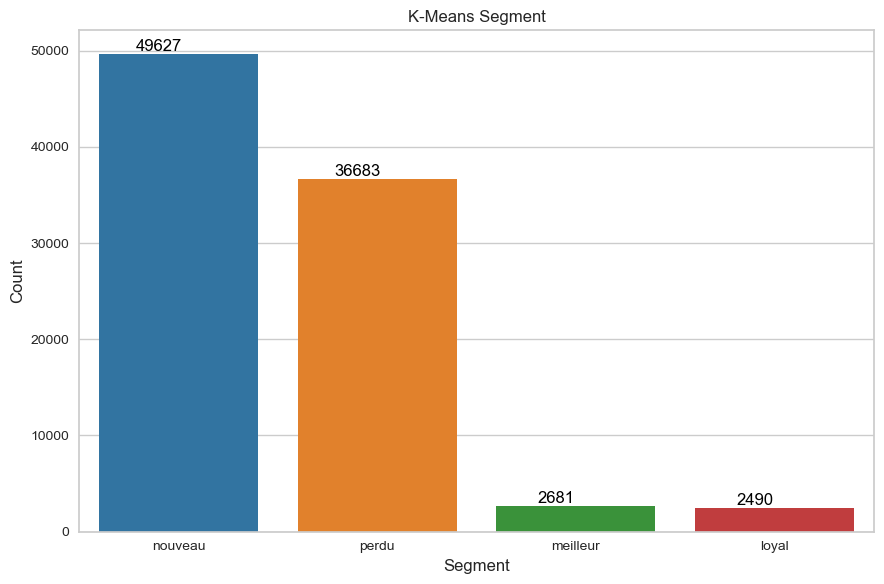

In [89]:
plt.figure(figsize=(9, 6))
df_kmeans_count = df_kmeans_scaled['k_means_segment'].value_counts()
pal = sns.color_palette('tab10', len(df_kmeans_count))
graph =sns.barplot(x=df_kmeans_count.index, y=df_kmeans_count.values, palette=pal) 
for p in graph.patches:
        graph.annotate('{:.0f}'.format(p.get_height()), (p.get_x()+0.3, p.get_height()),
                    ha='center', va='bottom',
                    color= 'black')     
plt.title('K-Means Segment', size=12)
plt.ylabel('Nombre de client')
plt.xlabel('Segment')
plt.tight_layout()
plt.show()

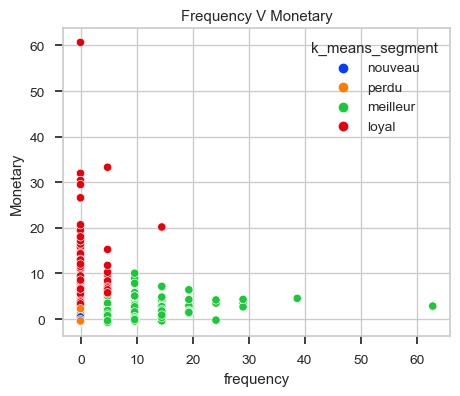

In [100]:
# Frequency V Monetary
plt.figure(figsize = (5, 4) )
sns.set_context(context = 'notebook', font_scale=0.9)
sns.scatterplot(x = 'Frequency', y = 'Monetary', hue = 'k_means_segment',data = df_kmeans_scaled,palette='bright')
plt.title('Frequency V Monetary')
plt.ylabel('Monetary')
plt.xlabel('frequency')
plt.show()

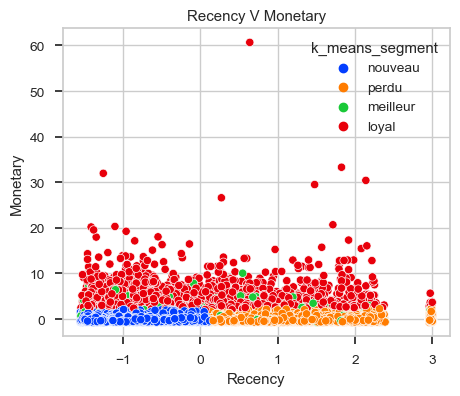

In [99]:
# # Monetary V Recency
plt.figure(figsize = (5, 4) )
sns.set_context(context = 'notebook', font_scale=0.9)
sns.scatterplot(x = 'Recency', y = 'Monetary', hue = 'k_means_segment',data = df_kmeans_scaled,palette='bright')
plt.title('Recency V Monetary')
plt.ylabel('Monetary')
plt.xlabel('Recency')
plt.show()

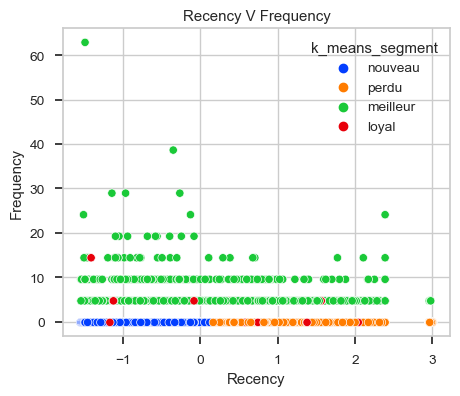

In [101]:
# # Monetary V Recency
plt.figure(figsize = (5, 4) )
sns.set_context(context = 'notebook', font_scale=0.9)
sns.scatterplot(x = 'Recency', y = 'Frequency', hue = 'k_means_segment',data = df_kmeans_scaled,palette='bright')
plt.title('Recency V Frequency')
plt.ylabel('Frequency')
plt.xlabel('Recency')
plt.show()

In [18]:
#RFM_simul= RFM.merge(df[['order_purchase_timestamp', 'customer_unique_id','review_score' ]], on='customer_unique_id')

In [19]:
#RFM_simul

,customer_unique_id,Recency,Frequency,Monetary,order_purchase_timestamp,review_score
0,0000366f3b9a7992bf8c76cfdf3221e2,110,1,141.90,2018-05-10 10:56:27,5
1,0000b849f77a49e4a4ce2b2a4ca5be3f,113,1,27.19,2018-05-07 11:11:27,4
2,0000f46a3911fa3c0805444483337064,536,1,86.22,2017-03-10 21:05:03,3
3,0000f6ccb0745a6a4b88665a16c9f078,320,1,43.62,2017-10-12 20:29:41,4
4,0004aac84e0df4da2b147fca70cf8255,287,1,196.89,2017-11-14 19:45:42,5
...,...,...,...,...,...,...
94483,fffcf5a5ff07b0908bd4e2dbc735a684,446,1,2067.42,2017-06-08 21:00:36,5
94484,fffea47cd6d3cc0a88bd621562a9d061,261,1,84.58,2017-12-10 20:07:56,4
94485,ffff371b4d645b6ecea244b27531430a,567,1,112.46,2017-02-07 15:49:16,5
94486,ffff5962728ec6157033ef9805bacc48,118,1,133.69,2018-05-02 15:17:41,5
